In [1]:
import numpy as np

In [2]:
# Sigmoid 函数
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

In [3]:
# 计算损失函数（逻辑回归的交叉熵损失）
def compute_loss(x, y, w, b):
    epsilon = 1e-7  # 防止对数为零
    z = np.dot(x, w) + b
    pdic = sigmoid(z)
    
    # 添加epsilon防止log(0)
    pdic = np.clip(pdic, epsilon, 1 - epsilon)
    
    loss = -np.mean(y * np.log(pdic) + (1 - y) * np.log(1 - pdic))
    return loss

In [4]:
# 梯度下降函数
def gradient_descent(x, y, w, b, lr, ni):
    m = len(y)
    lh = []
    
    for index in range(ni):
        z = np.dot(x, w) + b
        pdic = sigmoid(z)

        # 计算梯度
        dw = np.dot(x.T, (pdic - y)) / m
        db = np.sum(pdic - y) / m

        # 更新参数
        w -= lr * dw
        b -= lr * db

        # 记录损失值
        loss = compute_loss(x, y, w, b)
        lh.append(loss)

        # 每100次迭代打印一次损失值
        if index % 100 == 0:
            loss = compute_loss(x, y, w, b)
            print(f"Iteration {index}: Loss = {loss:.2f}")

    return w, b, lh

In [5]:
# 训练逻辑回归模型
def train_logistic_regression(x, y, lr=0.01, ni=2000):
    # 初始化权重和偏置项
    w = np.zeros(features.shape[1])
    b = 0.0

    # 执行梯度下降
    w, b, lh = gradient_descent(x, y, w, b, lr, ni)

    return w, b, lh

In [6]:
features = np.array([[22.48, 1.32],
                     [39.68, 2.89],
                     [35.30, 3.47],
                     [30.61, 0.91],
                     [43.34, 2.94],
                     [16.49, 0.97],
                     [44.96, 2.79],
                     [30.12, 3.68],
                     [20.08, 1.05],
                     [36.58, 3.13]])

target = np.array([0, 0, 1, 0, 1, 0, 1, 1, 0, 1])

# 训练模型
weights, bias, loss_history = train_logistic_regression(features, target)

# 输出最终的权重和偏置
print("\nTrained Weights:", np.array2string(weights, 
                                            formatter={'float_kind':lambda x: f'{x:.2f}'}))
print("Trained Bias:", f'{bias:.2f}')

Iteration 0: Loss = 0.72
Iteration 100: Loss = 1.02
Iteration 200: Loss = 0.95
Iteration 300: Loss = 0.89
Iteration 400: Loss = 0.82
Iteration 500: Loss = 0.76
Iteration 600: Loss = 0.71
Iteration 700: Loss = 0.65
Iteration 800: Loss = 0.61
Iteration 900: Loss = 0.57
Iteration 1000: Loss = 0.53
Iteration 1100: Loss = 0.50
Iteration 1200: Loss = 0.47
Iteration 1300: Loss = 0.45
Iteration 1400: Loss = 0.43
Iteration 1500: Loss = 0.41
Iteration 1600: Loss = 0.39
Iteration 1700: Loss = 0.38
Iteration 1800: Loss = 0.38
Iteration 1900: Loss = 0.37

Trained Weights: [-0.08 1.92]
Trained Bias: -1.39


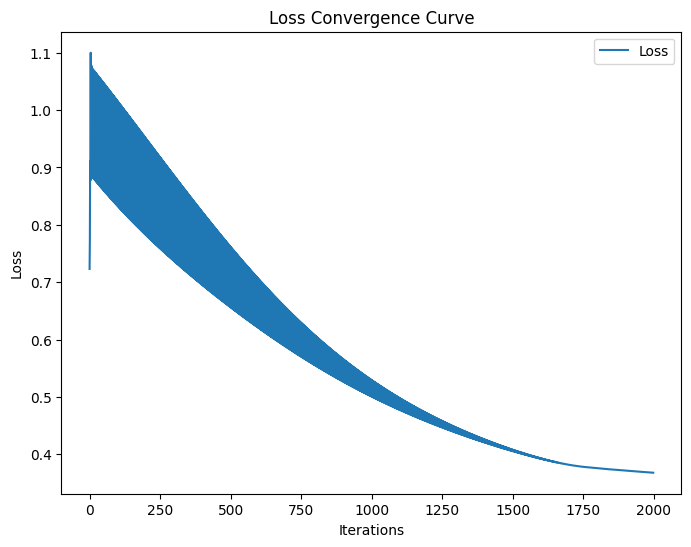

In [135]:
import matplotlib.pyplot as plt

# 绘制损失函数的收敛曲线
plt.figure(figsize=(8, 6)) 
plt.plot(loss_history, label='Loss')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Loss Convergence Curve')
plt.legend()
plt.show()

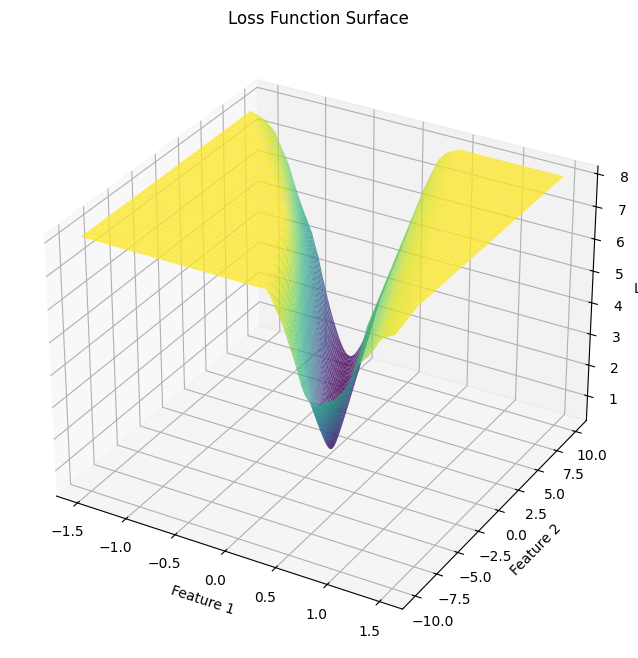

In [136]:
# 绘制最终损失函数的3D图
# 生成网格数据
w1_range = np.linspace(-1.5, 1.5, 500)  # 权重 w1 的范围
w2_range = np.linspace(-10, 10, 500)  # 权重 w2 的范围
W1, W2 = np.meshgrid(w1_range, w2_range)

loss_surface = np.zeros_like(W1)
# 遍历网格中的每个点，计算损失函数值
for i in range(len(W1)):
    for j in range(len(W2)):
        temp_weights = np.array([W1[i, j], W2[i, j]])
        loss_surface[i, j] = compute_loss(features, target, temp_weights, bias)

# 绘制3D图
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(W1, W2, loss_surface, cmap='viridis', alpha=0.8)

ax.set_xlabel('Feature 1')
ax.set_ylabel('Feature 2')
ax.set_zlabel('Loss')
ax.set_title('Loss Function Surface')

plt.show()

In [7]:
import plotly.graph_objects as go
import numpy as np

# 生成网格数据
w1_range = np.linspace(-1.5, 1.5, 500)  # 权重 w1 的范围
w2_range = np.linspace(-5, 5, 500)  # 权重 w2 的范围
W1, W2 = np.meshgrid(w1_range, w2_range)

# 计算损失函数的表面
loss_surface = np.zeros_like(W1)
for i in range(W1.shape[0]):
    for j in range(W2.shape[1]):
        temp_weights = np.array([W1[i, j], W2[i, j]])
        loss_surface[i, j] = compute_loss(features, target, temp_weights, bias)

# # 计算缩放因子
# x_range = np.ptp(w1_range)  # x轴的范围（peak-to-peak range）
# y_range = np.ptp(w2_range)  # y轴的范围（peak-to-peak range）
# 
# # 计算缩放因子，以便将 y 轴范围缩小到与 x 轴一致
# scale_factor = x_range / y_range
# 
# # 应用缩放因子
# W2_scaled = W2 * scale_factor

# 创建 Plotly 图形
fig = go.Figure(data=[go.Surface(z=loss_surface, x=W1, y=W2, colorscale='Viridis')])
fig.update_layout(title='Loss Function Surface',
                  scene=dict(
                      xaxis_title='Weight 1 (w1)',
                      yaxis_title='Weight 2 (w2)',
                      zaxis_title='Loss',
                      xaxis=dict(range=[-1.5, 1.5]),  # 设置 x 轴范围
                      yaxis=dict(range=[-5, 5]),    # 设置 y 轴范围
                      zaxis=dict(range=[loss_surface.min(), loss_surface.max()]),  # 设置 z 轴范围
                      aspectmode='manual',  # 手动设置坐标轴比例
                      aspectratio=dict(x=1, y=1, z=1)  # 设置比例
                  ))

fig.show()